# Day 6 - Simple 2D Movies

Let's start with things we already know - making some simple movies.

First, let's read in a model we have saved:

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
data = np.genfromtxt('/Users/mochathedog/Downloads/myPlanetSystems.txt', delimiter=',')

In [3]:
data.shape

(8800, 44)

In [4]:
#t_h and e_h are first
t_h, e_h = data[:,0], data[:,1]

# now we can calculate # of planets+star
n_part = int((data.shape[1]-2)/6)
n_part

7

So, let's reformat into (# particles), 3, (# times) for r_h and v_h:

In [5]:
r_h, v_h = np.zeros([n_part, 3, data.shape[0]]), np.zeros([n_part, 3, data.shape[0]])

In [6]:
# fill
for i in range(n_part):
    r_h[i,0,:] = data[:,2+i*r_h.shape[1]]
    r_h[i,1,:] = data[:,2+i*r_h.shape[1]+1] 
    r_h[i,2,:] = data[:,2+i*r_h.shape[1]+2] 
    
for i in range(n_part):
    v_h[i,0,:] = data[:,2+r_h.shape[1]*r_h.shape[0] +i*r_h.shape[1]] 
    v_h[i,1,:] = data[:,2+r_h.shape[1]*r_h.shape[0] +i*r_h.shape[1]+1] 
    v_h[i,2,:] = data[:,2+r_h.shape[1]*r_h.shape[0] +i*r_h.shape[1]+2] 

r_h.shape

(7, 3, 8800)

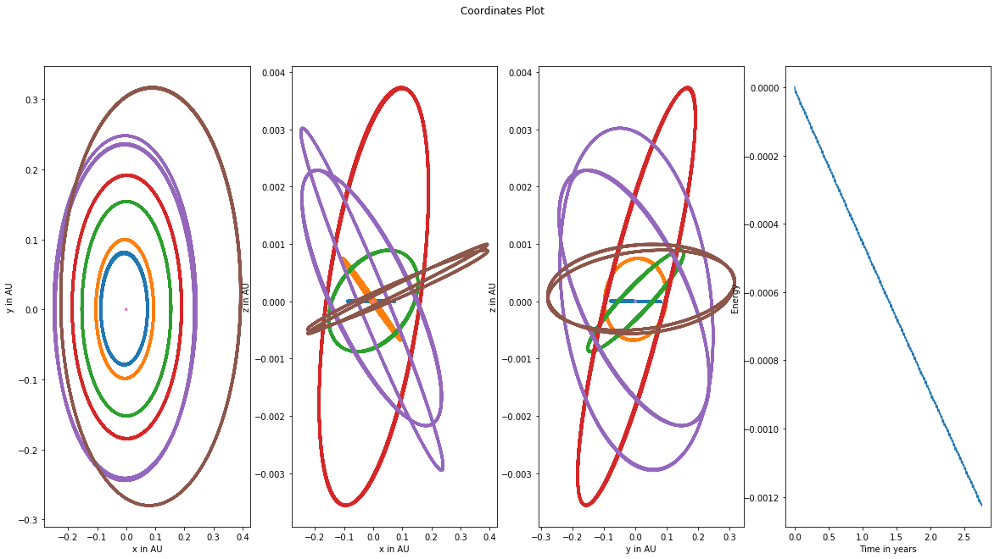

In [7]:
# we can test-replot like we did before:
fig, ax = plt.subplots(1, 4, figsize = (10*2, 10))
fig.suptitle('Coordinates Plot')

# for plots 0->2
ax[0].set_xlabel('x in AU')
ax[0].set_ylabel('y in AU')

ax[1].set_xlabel('x in AU')
ax[1].set_ylabel('z in AU')

ax[2].set_xlabel('y in AU')
ax[2].set_ylabel('z in AU')

# plot Euler's solution, particle 1, x-y
for i in range(n_part):
    ax[0].plot(r_h[i,0,:], r_h[i,1,:], lw=3)

for i in range(n_part):
    ax[1].plot(r_h[i,0,:], r_h[i,2,:], lw=3)

for i in range(n_part):
    ax[2].plot(r_h[i,1,:], r_h[i,2,:], lw=3)
    
    
ax[3].set_xlabel('Time in years')
ax[3].set_ylabel('Energy')
# re-norm energy
ax[3].plot(t_h, e_h)

plt.show()

## Animations

How would we make an animation of this?  We can recall some of the code from lesson02, oh so long ago & modify it for our purposes:

In [8]:
# if you get an error try:
!pip install JSAnimation

from JSAnimation.IPython_display import display_animation
from matplotlib import animation

In [9]:
stepSize = 88
# start with step size -> trial will be 100 frames

In [10]:
# start:stop:step
r = r_h[:,:,0:-1:stepSize]
t = t_h[0:-1:stepSize]
E = e_h[0:-1:stepSize]

nFrames = len(t)

print('Number of frames = ', nFrames)

#r.shape

Number of frames =  100


(-0.0012099565896341949, -0.0)

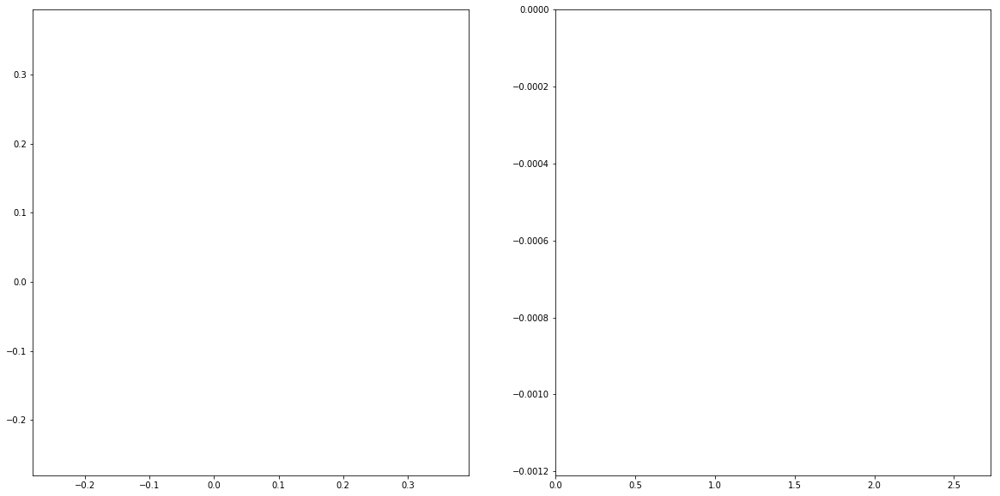

In [11]:
# initalize our figure
fig, ax = plt.subplots(1, 2, figsize = (10*2, 10))

# empty placeholders for different plots
trajs = []
for i in range(n_part):
    tr, = ax[0].plot([],[])
    trajs.append(tr)

energy, = ax[1].plot([],[])

# set bounds
ax[0].set_xlim(r.min(), r.max())
ax[0].set_ylim(r.min(), r.max())

ax[1].set_xlim(t.min(),t.max())
ax[1].set_ylim(E.min(),E.max())

#print(trajs)
#print(' ')
#print(energy)

Notes: above modified following https://stackoverflow.com/questions/20624408/matplotlib-animating-multiple-lines-and-text


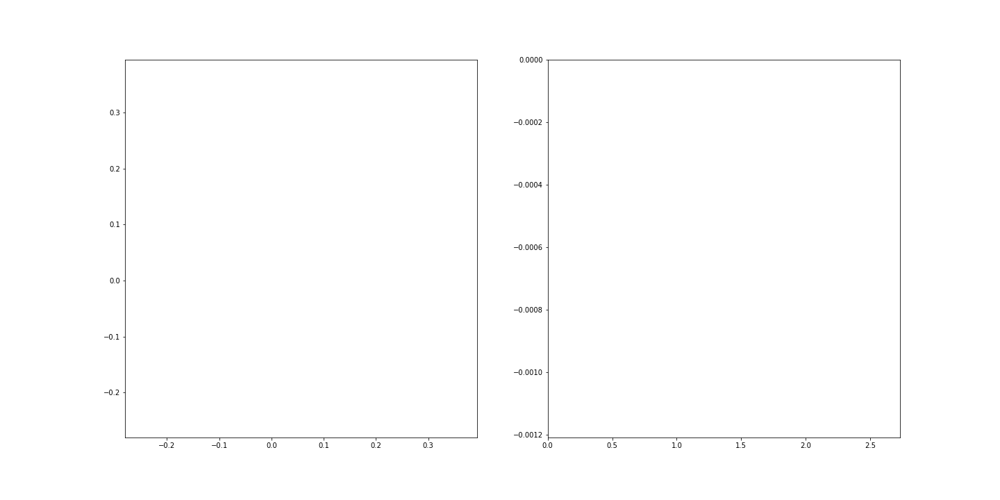
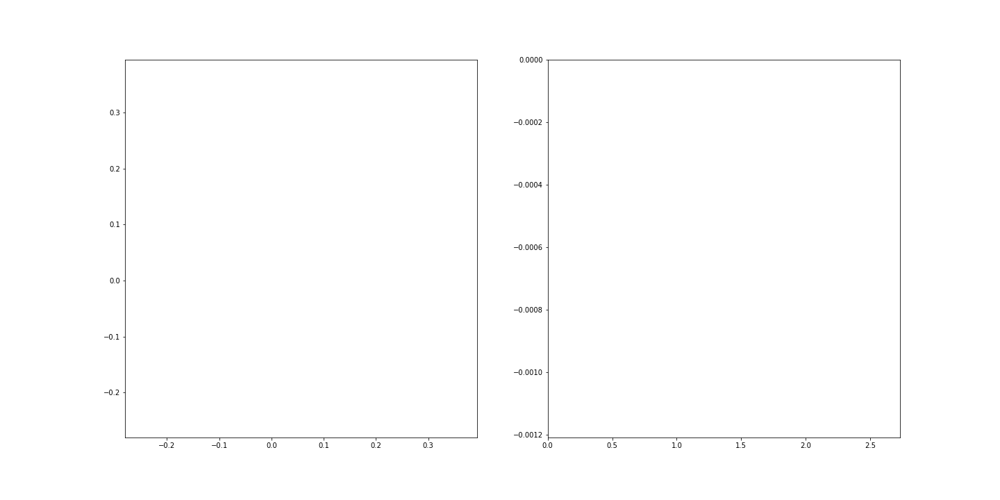
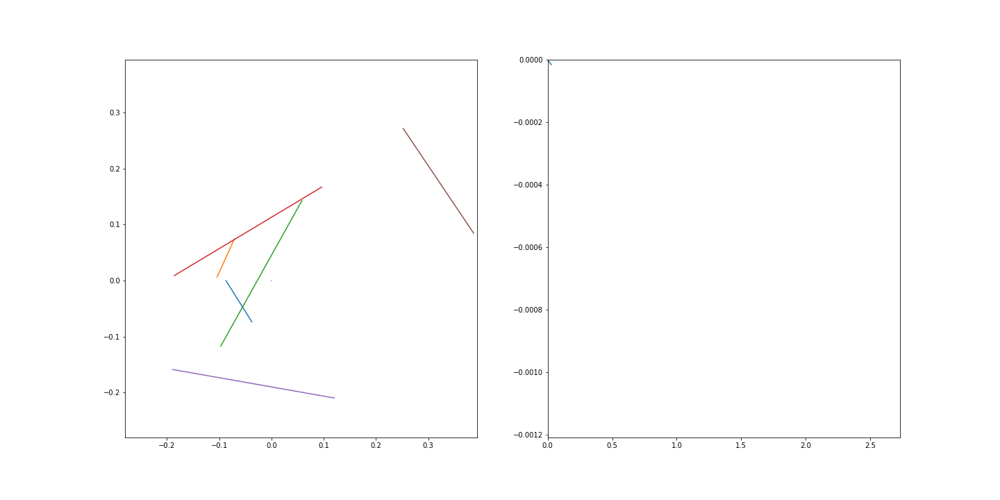
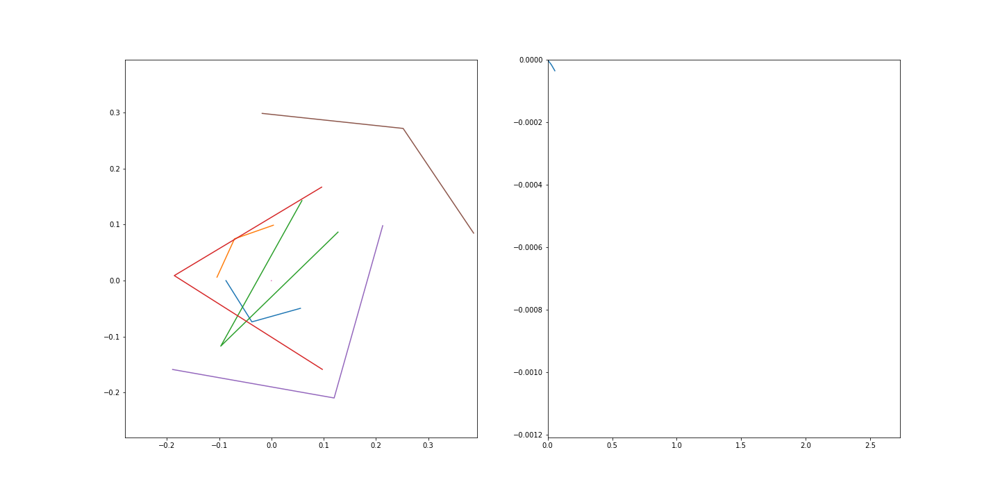
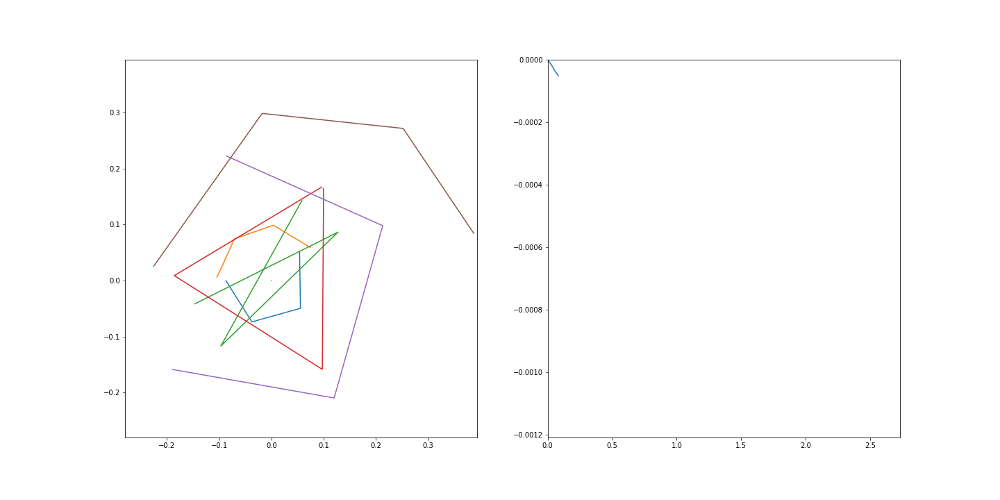
...
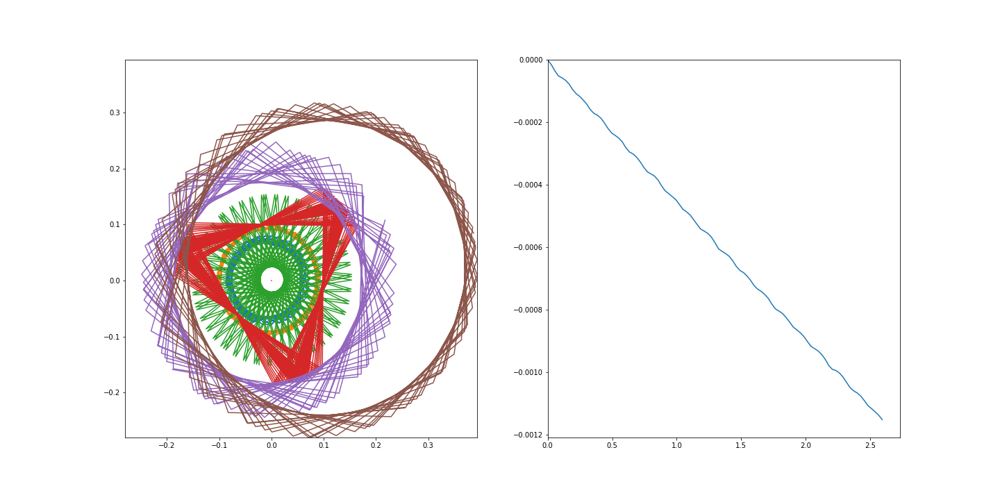
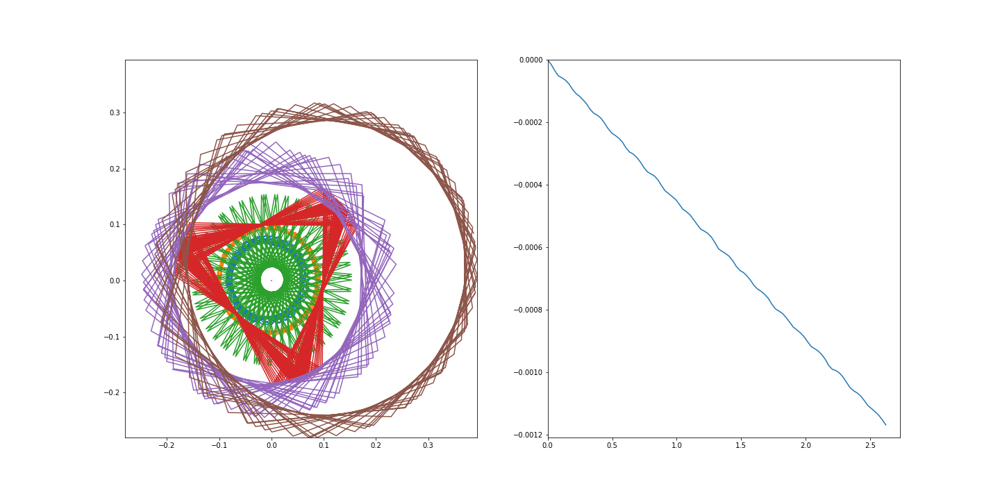
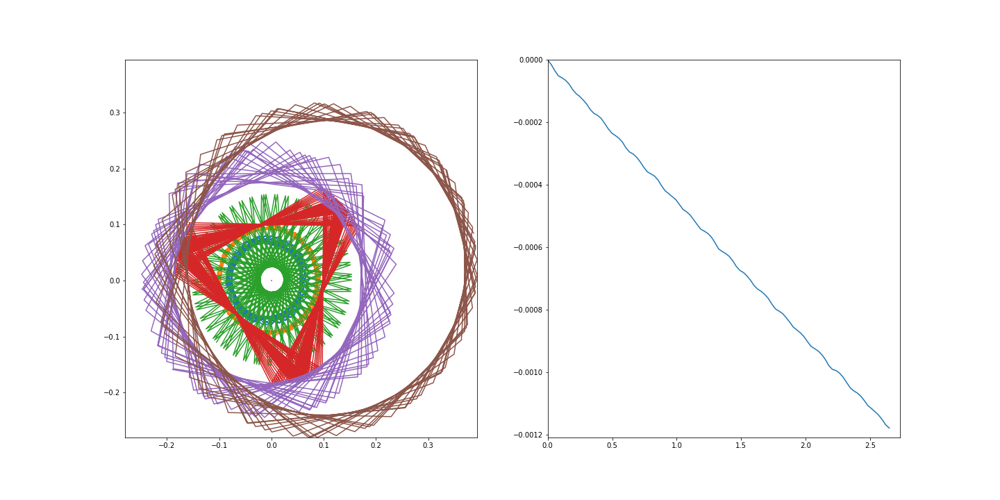
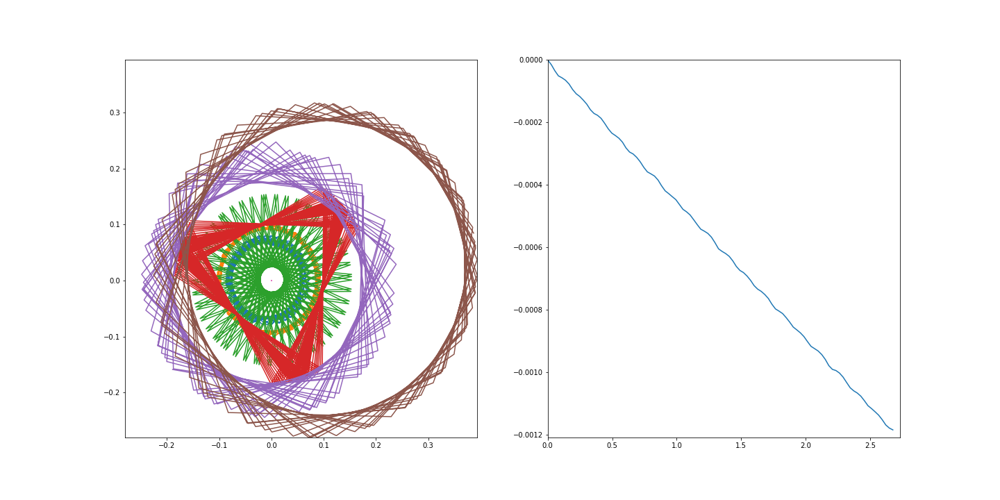
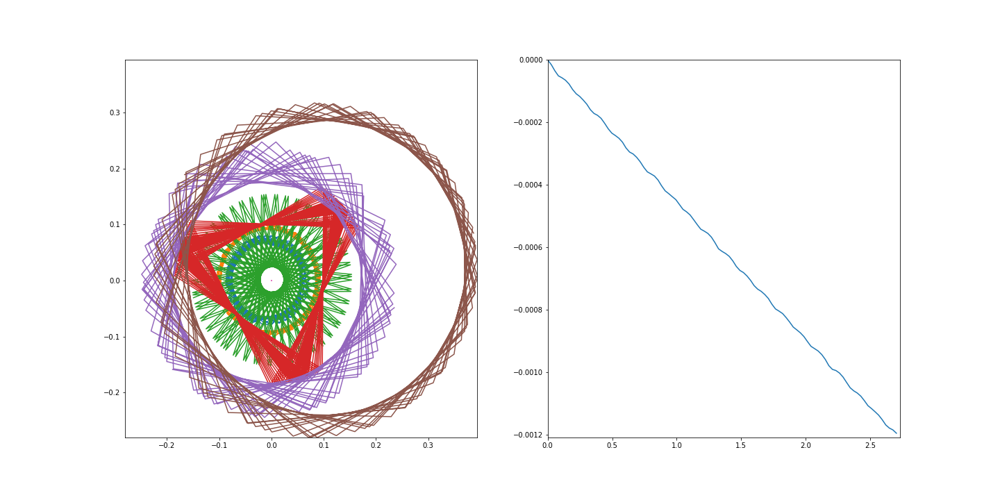

In [12]:
# we need to initialize stuff - just setting data
def init():
    # multiple planets
    for trajectory in trajs:
        #print(trajectory)
        trajectory.set_data([],[])
    
    energy.set_data([], [])
    
    # note: we have to do some special formatting to 
    #  get the correct output form for animate function
    outarr = trajs.copy()
    outarr.append(energy)
    return tuple(outarr)

# now, each time we step through
def animate(i):
    for j,trajectory in enumerate(trajs):
        trajectory.set_data(r[j,0,:i], 
                             r[j,1,:i])
    
    energy.set_data(t[:i], E[:i])
    
    # note: we have to do some special formatting to 
    #  get the correct output form for animate function    
    outarr = trajs.copy()
    outarr.append(energy)
    return tuple(outarr)
    
  
# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nFrames, interval=20, blit=True)

# call our new function to display the animation
display_animation(anim)

Ok, the above is pretty neat (looks cool with the short number of frames we have here) - but how do we save it as a movie we can post places?  Turns out that is relatively easy with a few lines of code:

In [13]:
# note: if you get a "ffmpeg not found" error try:

# I think its this one 
#  you might have to restart kernel after this
#!conda install -c conda-forge ffmpeg --yes 

# probably not this one
#!pip install imageio-ffmpeg



In [14]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=15, metadata=dict(artist='Me'), bitrate=1800)

In [16]:
# save!
anim.save('/Users/mochathedog/Downloads/anim.mp4', writer=writer)

### Exercise
Repeat making movies using this method for your own system.  Try different angles.  Think about any symbols you want to add - arrows? How would you add a dot to show where the planet is? (Hint: google "matplotlib marker styles"

Bonus: make movies for galaxy simulations